# Install

In [ ]:
from google.colab import drive

#short cut for gdrive
drive.mount('/content/gdrive')
!ln -fs /content/gdrive/MyDrive /app

Mounted at /content/gdrive


In [ ]:
# 抓取yolov4
!git clone https://github.com/AlexeyAB/darknet darknet

# 修改Darknet設定，符合Colab環境
%cd /content/darknet/
!sed -i "s/GPU=0/GPU=1/g" Makefile
!sed -i "s/CUDNN=0/CUDNN=1/g" Makefile
!sed -i "s/OPENCV=0/OPENCV=1/g" Makefile
!apt update
!apt-get install libopencv-dev

# 編譯
!make clean
!make

# 抓取預先訓練完的權重
!wget https://pjreddie.com/media/files/yolov3.weights
!wget https://pjreddie.com/media/files/darknet53.conv.74
!wget https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.weights
!wget https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.conv.137

Cloning into 'darknet'...
remote: Enumerating objects: 15308, done.
remote: Total 15308 (delta 0), reused 0 (delta 0), pack-reused 15308
Receiving objects: 100% (15308/15308), 13.69 MiB | 16.97 MiB/s, done.
Resolving deltas: 100% (10404/10404), done.
/content/darknet
Get:1 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:2 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Ign:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Ign:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release
Hit:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Hit:7 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:8 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Hit:9 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/

In [ ]:
#測試
!./darknet detect cfg/yolov4.cfg yolov4.weights data/person.jpg


 CUDA-version: 11000 (11020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 3.2.0
 0 : compute_capability = 370, cudnn_half = 0, GPU: Tesla K80 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x

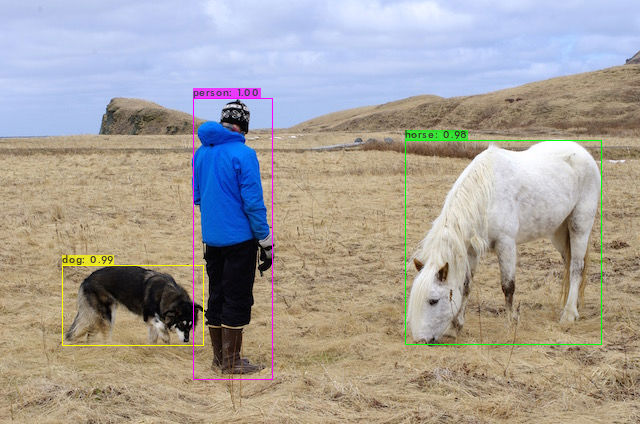

In [ ]:
#展示圖片
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread("predictions.jpg", cv2.IMREAD_UNCHANGED)
cv2_imshow(img)

In [ ]:
# 製作壓縮檔
%cd /content/
!zip -r darknet.zip darknet
!cp darknet.zip /app/darknet.zip

/content
updating: darknet/ (stored 0%)
updating: darknet/yolov3.weights (deflated 7%)
updating: darknet/darknet (deflated 62%)
updating: darknet/darknet_video.py (deflated 70%)
updating: darknet/video_yolov3.sh (deflated 21%)
updating: darknet/include/ (stored 0%)
updating: darknet/include/yolo_v2_class.hpp (deflated 78%)
updating: darknet/include/darknet.h (deflated 74%)
updating: darknet/predictions.jpg (deflated 1%)
updating: darknet/backup/ (stored 0%)
updating: darknet/image_yolov4.sh (deflated 20%)
updating: darknet/yolov4.weights (deflated 7%)
updating: darknet/3rdparty/ (stored 0%)
updating: darknet/3rdparty/pthreads/ (stored 0%)
updating: darknet/3rdparty/pthreads/include/ (stored 0%)
updating: darknet/3rdparty/pthreads/include/pthread.h (deflated 76%)
updating: darknet/3rdparty/pthreads/include/semaphore.h (deflated 63%)
updating: darknet/3rdparty/pthreads/include/sched.h (deflated 62%)
updating: darknet/3rdparty/pthreads/bin/ (stored 0%)
updating: darknet/3rdparty/pthreads/

# Import darknet from gdrive

In [1]:
# 確認GPU
# 參考https://jason-chen-1992.weebly.com/
!nvidia-smi

Tue Aug 31 14:15:17 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.57.02    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   70C    P8    35W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
from google.colab import drive
import os

# 製作捷徑
drive.mount('/content/gdrive')
!ln -fs /content/gdrive/MyDrive /app

#複製darknet壓縮檔
!cp /app/darknet.zip /content/darknet.zip
#解壓縮
!unzip /content/darknet.zip

%cd darknet

Mounted at /content/gdrive
Archive:  /content/darknet.zip
   creating: darknet/
  inflating: darknet/yolov3.weights  
  inflating: darknet/darknet         
  inflating: darknet/darknet_video.py  
  inflating: darknet/video_yolov3.sh  
   creating: darknet/include/
  inflating: darknet/include/yolo_v2_class.hpp  
  inflating: darknet/include/darknet.h  
  inflating: darknet/predictions.jpg  
   creating: darknet/backup/
  inflating: darknet/image_yolov4.sh  
  inflating: darknet/yolov4.weights  
   creating: darknet/3rdparty/
   creating: darknet/3rdparty/pthreads/
   creating: darknet/3rdparty/pthreads/include/
  inflating: darknet/3rdparty/pthreads/include/pthread.h  
  inflating: darknet/3rdparty/pthreads/include/semaphore.h  
  inflating: darknet/3rdparty/pthreads/include/sched.h  
   creating: darknet/3rdparty/pthreads/bin/
  inflating: darknet/3rdparty/pthreads/bin/pthreadGC2.dll  
  inflating: darknet/3rdparty/pthreads/bin/pthreadVC2.dll  
   creating: darknet/3rdparty/pthreads/l

# Training

In [ ]:
#(once)
# 將cfg檔複製到訓練資料夾下
%cp /content/darknet/cfg/yolov4.cfg /app/cat_recognize/picture/cats_alter/cfg/yolov4_train1.cfg

# 修改cfg檔以符合訓練資料
%cd /app/cat_recognize/picture/cats_alter/cfg
!sed -i "s/width=608/width=416/g" yolov4_train1.cfg
!sed -i "s/height=608/height=416/g" yolov4_train1.cfg
!sed -i "s/subdivisions=8/subdivisions=64/g" yolov4_train1.cfg
!sed -i "s/max_batches = 500500/max_batches = 2000/g" yolov4_train1.cfg
!sed -i "s/steps=400000,450000/steps=1600,1800/g" yolov4_train1.cfg
!sed -i "968c classes=1" yolov4_train1.cfg 
!sed -i "1056c classes=1" yolov4_train1.cfg 
!sed -i "1144c classes=1" yolov4_train1.cfg
!sed -i "961c filters=18" yolov4_train1.cfg
!sed -i "1049c filters=18" yolov4_train1.cfg
!sed -i "1137c filters=18" yolov4_train1.cfg

#建立儲存訓練權重的資料夾
!mkdir /app/cat_recognize/picture/out2yolo/backup

In [ ]:
%cd /content/darknet/

!./darknet detector train /app/cat_recognize/picture/out2yolo/obj.data /app/cat_recognize/picture/cats_alter/cfg/yolov4_train1.cfg yolov4.conv.137 -dont_show

串流輸出內容已截斷至最後 5000 行。
 total_bbox = 759128, rewritten_bbox = 0.000000 % 
v3 (iou loss, Normalizer: (iou: 0.07, obj: 1.00, cls: 1.00) Region 139 Avg (IOU: 0.000000), count: 1, class_loss = 0.000000, iou_loss = 0.000000, total_loss = 0.000000 
v3 (iou loss, Normalizer: (iou: 0.07, obj: 1.00, cls: 1.00) Region 150 Avg (IOU: 0.000000), count: 1, class_loss = 0.000001, iou_loss = 0.000000, total_loss = 0.000001 
v3 (iou loss, Normalizer: (iou: 0.07, obj: 1.00, cls: 1.00) Region 161 Avg (IOU: 0.857702), count: 3, class_loss = 0.000265, iou_loss = 0.592570, total_loss = 0.592835 
 total_bbox = 759131, rewritten_bbox = 0.000000 % 
v3 (iou loss, Normalizer: (iou: 0.07, obj: 1.00, cls: 1.00) Region 139 Avg (IOU: 0.000000), count: 1, class_loss = 0.000001, iou_loss = 0.000000, total_loss = 0.000001 
v3 (iou loss, Normalizer: (iou: 0.07, obj: 1.00, cls: 1.00) Region 150 Avg (IOU: 0.000000), count: 1, class_loss = 0.000000, iou_loss = 0.000000, total_loss = 0.000000 
v3 (iou loss, Normalizer: (iou: 

# Detect


In [ ]:
%cp /app/cat_recognize/picture/cats_alter/cfg/yolov4_train1.cfg /app/cat_recognize/picture/cats_alter/cfg/yolov4_test1.cfg
# 修改cfg檔以偵測
%cd /app/cat_recognize/picture/cats_alter/cfg
!sed -i "1 s/64/1/g" yolov4_test1.cfg
!sed -i "2 s/64/1/g" yolov4_test1.cfg
!sed -i "4 s/Training/Testing/g" yolov4_test1.cfg

/content/gdrive/MyDrive/cat_recognize/picture/cats_alter/cfg


/content/darknet
 CUDA-version: 11000 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 OpenCV version: 3.2.0
 0 : compute_capability = 370, cudnn_half = 0, GPU: Tesla K80 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     64       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  64 0.354 BF
   3 route  1 		                           ->  208 x 208 x  64 
   4 conv     64       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  64 0.354 BF
   5 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   6 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   8 conv     64       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  64 0.354 BF
   9 route  8 2 	                           ->  208 x 208

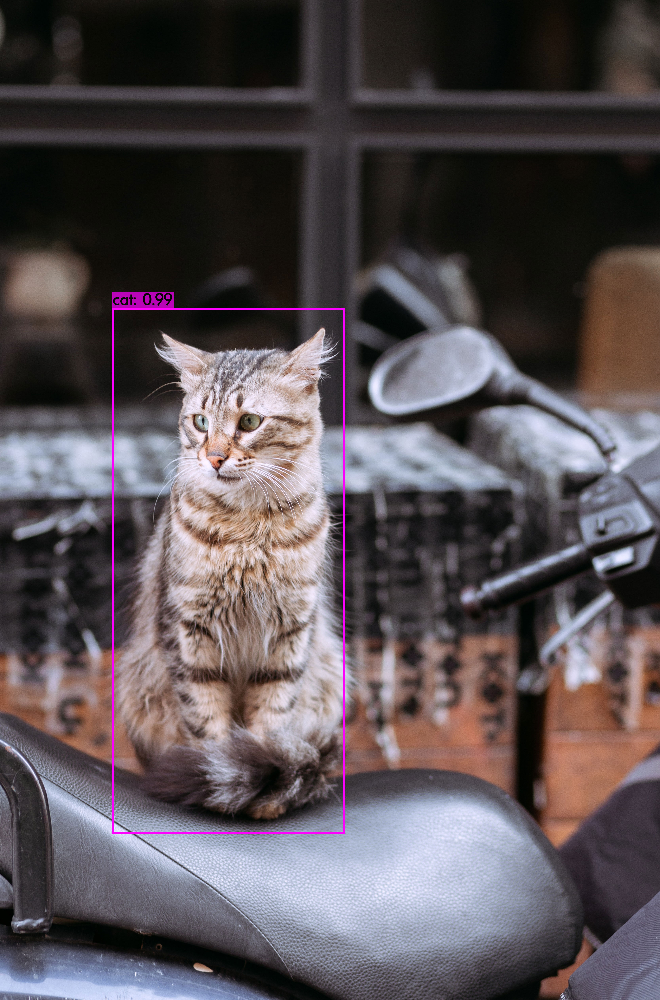

In [26]:
#單張圖片檢測
import cv2
from google.colab.patches import cv2_imshow

def img_show(img_name):
  img = cv2.imread(img_name, cv2.IMREAD_UNCHANGED)
  cv2_imshow(img)

%cd /content/darknet/
!./darknet detector test /app/cat_recognize/picture/out2yolo/obj.data /app/cat_recognize/picture/cats_alter/cfg/yolov4_test1.cfg /content/gdrive/MyDrive/cat_recognize/picture/out2yolo/backup/yolov4_train1_last.weights /app/cat_recognize/picture/cats/pexels-meruyert-gonullu-7317607.jpg > /content/gdrive/MyDrive/cat_recognize/picture/result/result.txt -dont_show

img_show('predictions.jpg')